Major steps: 
- Created two new csv files
- all_5classes_info.csv : Has infor for all painting for each of the 5 classes
- thousandperclass.csv: or 1000 randomly selected paintings from each category
- They are in the samira branch of our github

- There is code for creating the separate folder for all paintings of each style and also only the five thousand painting. However, I could not upload the files as they were too big (even when zipped). I gues you might have to run it on your computer to create those folders locally. 


In [93]:

import pandas as pd 
df = pd.read_csv('all_data_info.csv')

In [95]:
import os
file = os.listdir('train')

In [96]:
#list of styles we decided to work with
art_styles = ['Impressionism', 'Expressionism', 'Art Nouveau (Modern)', 'Surrealism', 'Cubism']

In [146]:
#making a new df of only the chosen styles 
df3 = pd.DataFrame()
for style in art_styles:
    df3 = pd.concat([df3, df[df['style'] == style]], axis = 0, ignore_index = True)

In [147]:
#listing the columns to drop
to_drop = ['date', 'genre', 'source', 'artist_group', 'in_train']

In [148]:
#dropping the above columns 
df3 = df3.drop(to_drop, axis=1)


In [149]:
#checking the columns 
df3.columns

Index(['artist', 'pixelsx', 'pixelsy', 'size_bytes', 'style', 'title',
       'new_filename'],
      dtype='object')

In [221]:
#function to make filepath 
def get_filepath(directory, img_name): 
    return directory+img_name
#function to check if the file exists or not
def file_exists(img_name): 
    return img_name in file

In [151]:
#creating a true/false column that checks if the file exists in the train folder. 
#Named the column 'filepath' by mistake. But stuck to it! 
df3['filepath'] = [file_exists(name) for name in df3['new_filename']] 

In [152]:
df3['filepath'].value_counts()

True     21773
False     6696
Name: filepath, dtype: int64

In [153]:
#checking the tail to make sue index matches with shape above
df3.tail() 

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
28464,Man Ray,365.0,420.0,50966.0,Cubism,Untitled,58868.jpg,True
28465,Ion Alin Gheorghiu,363.0,420.0,115456.0,Cubism,Hanging Garden,28834.jpg,False
28466,Marevna (Marie Vorobieff),315.0,480.0,35016.0,Cubism,Cubist Sunflowers,95093.jpg,True
28467,Le Corbusier,314.0,480.0,29847.0,Cubism,Ubu (Totem),45560.jpg,True
28468,Amadeo de Souza-Cardoso,293.0,512.0,77577.0,Cubism,House Manhufe,36564.jpg,True


In [154]:
#dropping all rows that do not have the image file  and then checking the shape to make sure they were dropped. 
df3 = df3.drop(df3[df3['filepath'] == False].index)   

df3.shape

(21773, 8)

In [156]:
#resetting index after drop
df3.reset_index(drop=True, inplace=True)
df3.tail()

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
21768,Henri Laurens,450.0,341.0,64190.0,Cubism,La guitar rose,9984.jpg,True
21769,Man Ray,365.0,420.0,50966.0,Cubism,Untitled,58868.jpg,True
21770,Marevna (Marie Vorobieff),315.0,480.0,35016.0,Cubism,Cubist Sunflowers,95093.jpg,True
21771,Le Corbusier,314.0,480.0,29847.0,Cubism,Ubu (Totem),45560.jpg,True
21772,Amadeo de Souza-Cardoso,293.0,512.0,77577.0,Cubism,House Manhufe,36564.jpg,True


In [158]:
#checking the count of each classes
df3['style'].value_counts()

Impressionism           8220
Expressionism           5325
Art Nouveau (Modern)    3779
Surrealism              3133
Cubism                  1316
Name: style, dtype: int64

In [160]:
#creating the actual filepaths column by overwriting the prev filepath column
df3['filepath'] = [get_filepath(name) for name in df3['new_filename']] 

In [161]:
df3.head()

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
0,Edgar Degas,5382.0,3349.0,1824204.0,Impressionism,Interior (The Rape),95360.jpg,train/95360.jpg
1,Claude Monet,4540.0,3611.0,4873803.0,Impressionism,"The Manneport, Rock Arch West of Etretat",49757.jpg,train/49757.jpg
2,Paul Signac,4464.0,3600.0,8730590.0,Impressionism,Rodez,53841.jpg,train/53841.jpg
3,Paul Signac,4470.0,3348.0,8710775.0,Impressionism,The Look at Montauban in rain,81912.jpg,train/81912.jpg
4,Ferdinand Hodler,3240.0,4548.0,9477034.0,Impressionism,Prayer in the Saint Pierre Cathedral in Geneva,17146.jpg,train/17146.jpg


In [228]:
#creating new csv for all paintings of the five classes
df3.to_csv('all_5classes_info.csv')

In [172]:
#creating new df with randomly chosen 1000 paintings from each class
new_df = pd.DataFrame()
for style in df3['style'].unique():
    df_new = df3[df3['style'] == style]
    df_new = df_new.sample(n=1000, random_state=1)
    new_df = pd.concat([new_df, df_new], axis = 0, ignore_index = True)

In [175]:
new_df.shape

(5000, 8)

In [176]:
new_df['style'].value_counts()

Cubism                  1000
Surrealism              1000
Art Nouveau (Modern)    1000
Expressionism           1000
Impressionism           1000
Name: style, dtype: int64

In [211]:
#new file for just the 5k files 
new_df.to_csv('thousandperclass.csv')

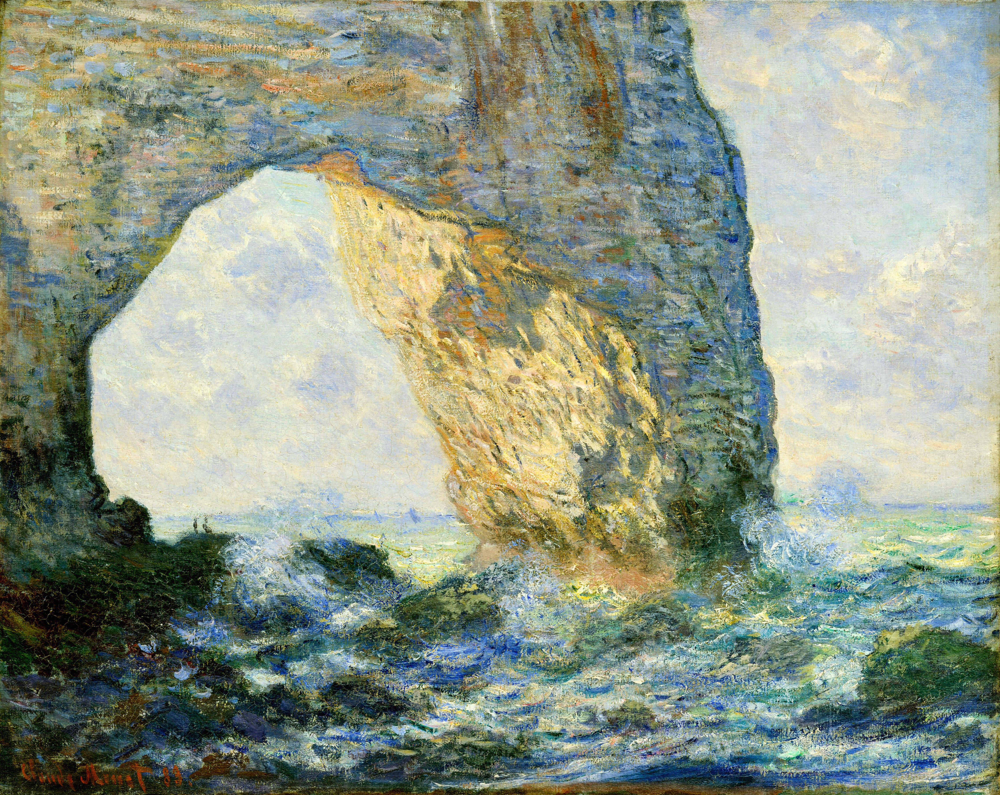

In [200]:
#checking if the file paths work 
from PIL import Image

img = Image.open('train/49757.jpg')
img

In [192]:
#creating new directory with all the paintings of five classes
import shutil
files = df3['filepath']
for f in files:
    shutil.copy(f, 'five_classes')

In [193]:
#checking if prev step worked
len(os.listdir('five_classes'))

21773

In [202]:
#Changing the file paths to make new filepaths that direct to the five_classes folder 
df3['filepath'] = [get_filepath('five_classes/', name) for name in df3['new_filename']] 

In [203]:
#changing the file paths 
new_df['filepath'] = [get_filepath('five_classes/', name) for name in new_df['new_filename']] 

In [207]:
df3.head(3)

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
0,Edgar Degas,5382.0,3349.0,1824204.0,Impressionism,Interior (The Rape),95360.jpg,five_classes/95360.jpg
1,Claude Monet,4540.0,3611.0,4873803.0,Impressionism,"The Manneport, Rock Arch West of Etretat",49757.jpg,five_classes/49757.jpg
2,Paul Signac,4464.0,3600.0,8730590.0,Impressionism,Rodez,53841.jpg,five_classes/53841.jpg


In [219]:
#moving only the 5k files to a new directory 
import shutil
files = new_df['filepath']
for f in files:
    shutil.copy(f,'5k')

In [208]:
new_df.head(3)

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
0,Eugene Boudin,1129.0,701.0,268010.0,Impressionism,"Trouville, Beach Scene",89516.jpg,five_classes/89516.jpg
1,Edgar Degas,728.0,1070.0,197637.0,Impressionism,Woman with Loose Red Hair,31047.jpg,five_classes/31047.jpg
2,John Singer Sargent,1218.0,845.0,83150.0,Impressionism,Melon Boats,64990.jpg,five_classes/64990.jpg


In [220]:
#checking if the above step worked 
len(os.listdir('5k'))

5000

In [213]:
new_df.head()

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
0,Eugene Boudin,1129.0,701.0,268010.0,Impressionism,"Trouville, Beach Scene",89516.jpg,five_classes/89516.jpg
1,Edgar Degas,728.0,1070.0,197637.0,Impressionism,Woman with Loose Red Hair,31047.jpg,five_classes/31047.jpg
2,John Singer Sargent,1218.0,845.0,83150.0,Impressionism,Melon Boats,64990.jpg,five_classes/64990.jpg
3,Paul Cezanne,2536.0,3249.0,635225.0,Impressionism,Self-portrait,8521.jpg,five_classes/8521.jpg
4,Gustave Caillebotte,2221.0,1409.0,660860.0,Impressionism,Game Birds And Lemons,60752.jpg,five_classes/60752.jpg


In [225]:
#changing the filepaths for new_df to refer to the 5k folder 
new_df['filepath'] = [get_filepath('5k/', name) for name in new_df['new_filename']] 

In [226]:
new_df.head(3)

,artist,pixelsx,pixelsy,size_bytes,style,title,new_filename,filepath
0,Eugene Boudin,1129.0,701.0,268010.0,Impressionism,"Trouville, Beach Scene",89516.jpg,5k/89516.jpg
1,Edgar Degas,728.0,1070.0,197637.0,Impressionism,Woman with Loose Red Hair,31047.jpg,5k/31047.jpg
2,John Singer Sargent,1218.0,845.0,83150.0,Impressionism,Melon Boats,64990.jpg,5k/64990.jpg


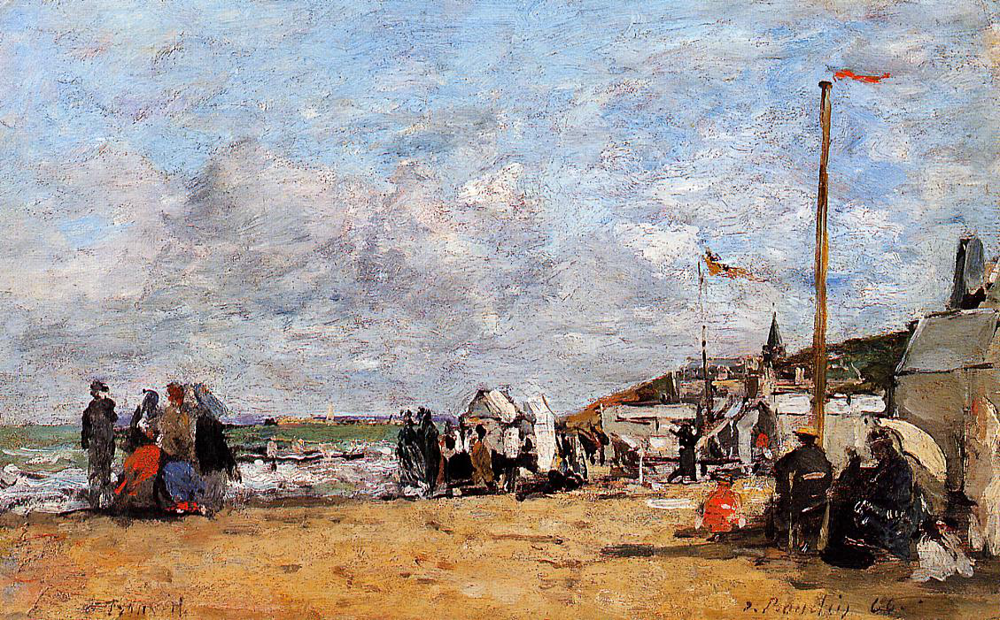

In [227]:
img = Image.open('5k/89516.jpg')
img